###### Alef Segura Santos, 9762942 | Gustavo de Moura Souza, 9762981 | Yago Rafael Pessoa, 9896218
# Visualização Computacional - SCC0252


In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
import matplotlib.pyplot as plt
plt.style.use('ggplot')

## América

In [2]:
# leitura do dataset e tratamento dos anos de algumas colunas para evitar problemas na manipulação
df_america = pd.read_csv('america.csv', index_col='País')
df_america.rename(index=str, columns={"continente":"Continente",
                              "direitos de propriedade":"Direitos Propriedade",
                              "Gasto do Governo":"Gasto Governo",
                              "Liberdade de negócio":"Liberdade Negócio",
                              "Liberdade de trabalho":"Liberdade Trabalho",
                              "Liberdade de Investimento":"Liberdade Investimento",
                              "Liberdade de comércio exterior":"Liberdade com. exterior"},
                              inplace=True)

### Visualizações Gerais

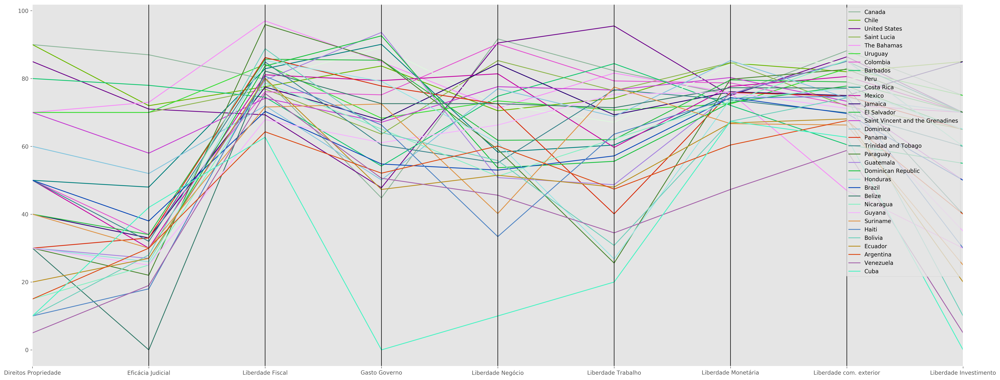

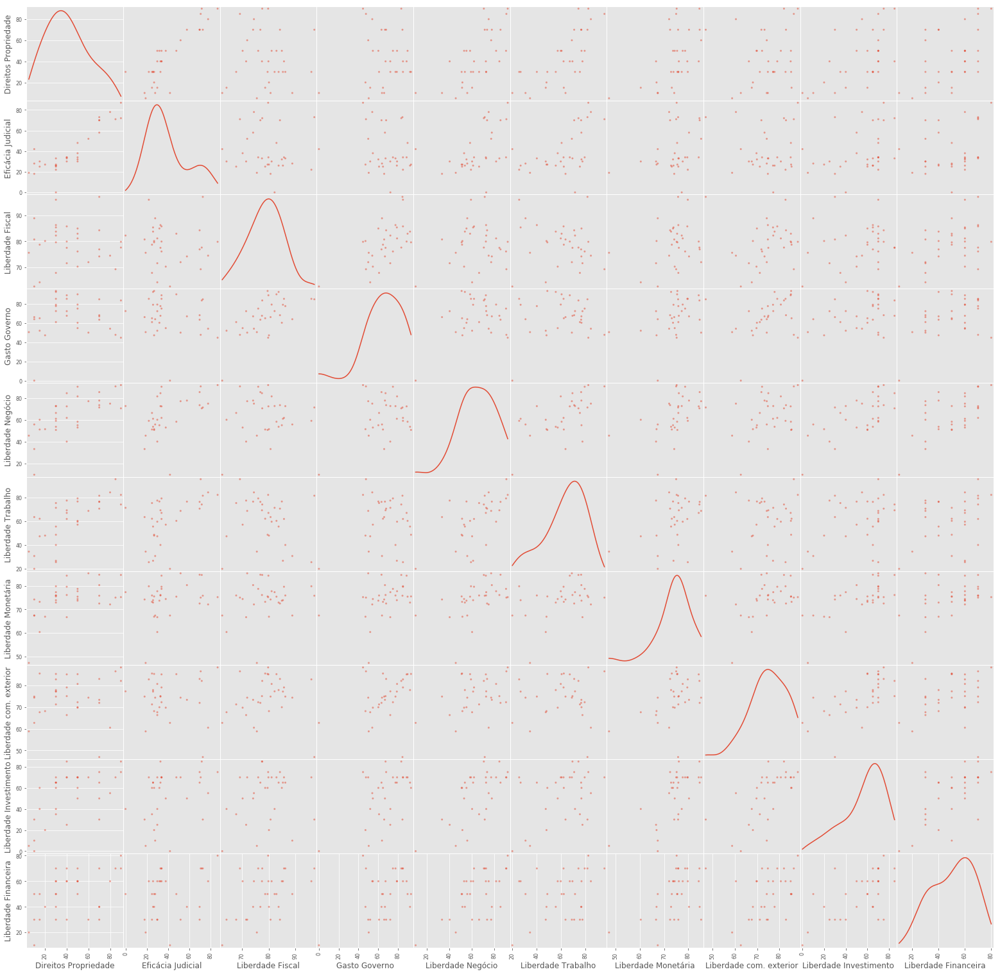

In [3]:
# média de cada continente em função das variáveis
for idx in df_america.index:
    df_america.loc[idx,'País'] = idx
plt.figure(figsize=(30, 12), dpi=300)
pd.plotting.parallel_coordinates(df_america, 'País', cols=df_america.columns[:9]);

# correlação entre as 10 variáveis da base
pd.plotting.scatter_matrix(df_america, figsize=(27,27), diagonal='kde', grid=False);

### Principal Component Analysis (PCA)

/usr/lib/python3/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by the scale function.
  


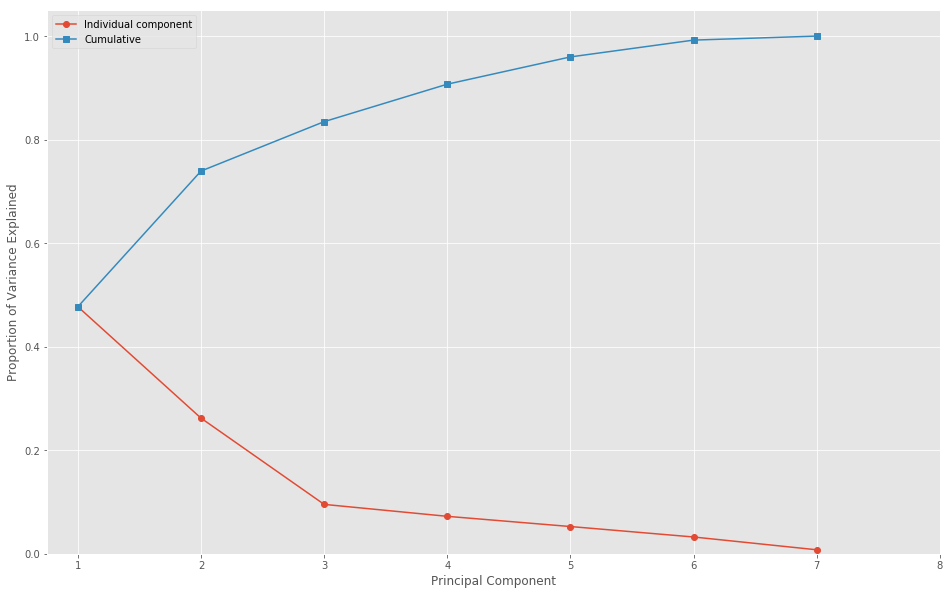

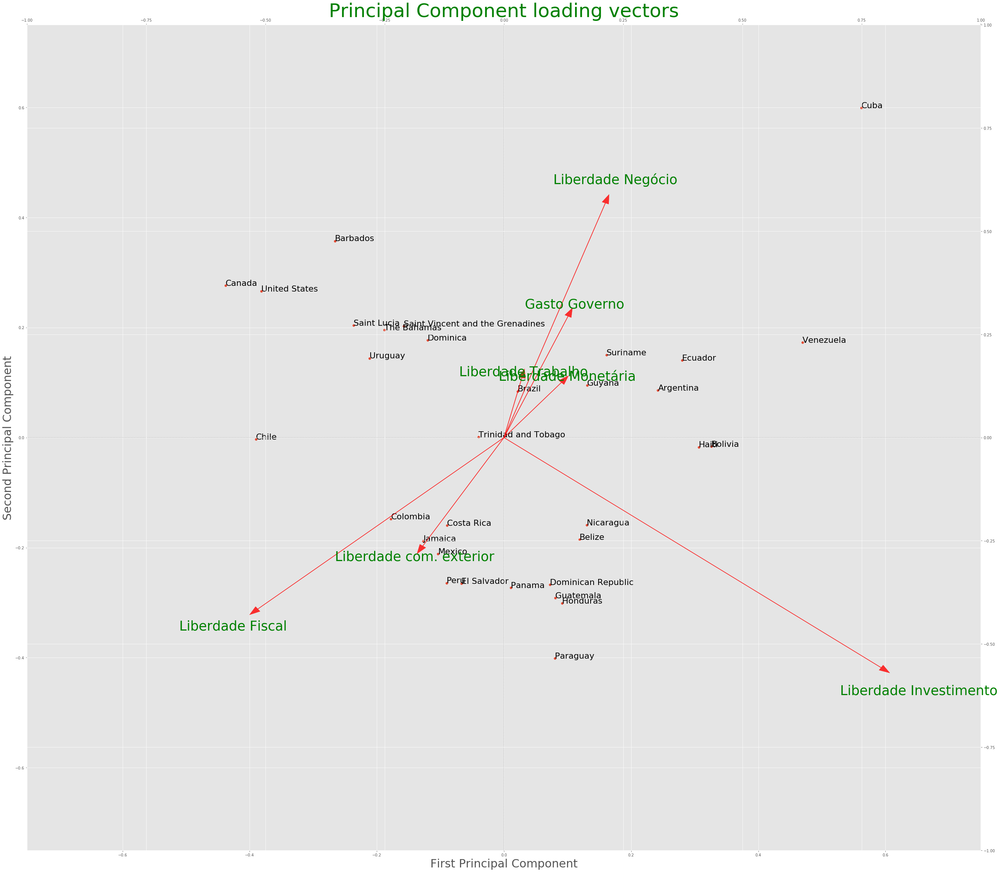

In [4]:
# Normalizando o dataset para a aplicação do PCA.
df_scaled = pd.DataFrame(scale(df_america.iloc[:,:9]), index=df_america.index, columns=df_america.columns[:9])

# Efetuando o PCA
pca = PCA()
pca.fit_transform(df_scaled.iloc[:, :-2])
plt.figure(figsize=(16, 10))

plt.plot(np.arange(1,pca.n_components_+1), pca.explained_variance_ratio_, '-o', label='Individual component')
plt.plot(np.arange(1,pca.n_components_+1), np.cumsum(pca.explained_variance_ratio_), '-s', label='Cumulative')

plt.ylabel('Proportion of Variance Explained')
plt.xlabel('Principal Component')
plt.xlim(0.75,4.25)
plt.ylim(0,1.05)
plt.xticks(np.arange(1,pca.n_components_+2))
plt.legend(loc=2);

# Aplicando o PCA para a geração do gráfico dos dois primeiros componentes.
pca = PCA()
df_plot = pd.DataFrame(pca.fit_transform(df_america.iloc[:,:10]),
                       columns=['PC'+str(i+1) for i in range(10)],
                       index=df_america.index)

# The loading vectors
pca_loadings = pd.DataFrame(pca.fit(df_scaled.iloc[:, :-2]).components_.T,
                            index=df_scaled.columns[:-2],
                            columns=['PC'+str(i+1) for i in range(pca.n_components_)])

# Plotando em imagem
fig , ax1 = plt.subplots(figsize=(45, 40))

lim=0.75
ax1.set_xlim(-lim,lim)
ax1.set_ylim(-lim,lim)

# Plot reference lines
ax1.hlines(0,-lim,lim, linestyles='dotted', colors='grey')
ax1.vlines(0,-lim,lim, linestyles='dotted', colors='grey')

ax1.set_xlabel('First Principal Component', fontsize=30)
ax1.set_ylabel('Second Principal Component', fontsize=30)
    
# Plot Principal Component loading vectors, using a second y-axis.
ax2 = ax1.twinx().twiny() 

ax2.set_ylim(-1,1)
ax2.set_xlim(-1,1)
ax2.tick_params(axis='y', colors='g')
ax2.set_xlabel('Principal Component loading vectors', color='g', fontsize=50)

xs = df_plot.iloc[:, 0]
ys = df_plot.iloc[:, 1]

coeff = pca.components_
labels = df_america.columns[2:]

scalex = 1.0/(xs.max()- xs.min())
scaley = 1.0/(ys.max()- ys.min())

ax1.scatter(xs*scalex, ys*scaley)
for i, country in enumerate(df_america['País']):
    ax1.annotate(country, (xs[i]*scalex, ys[i]*scaley), fontsize=22)

for i in range(pca.n_components_):
        plt.arrow(0, 0, coeff[i, 0], coeff[i, 1],color='r',alpha=0.8, head_width=0.015) 
        if labels is None:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, "Var"+str(i+1), color='g', ha='center', va='center', fontsize=35)
        else:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, labels[i], color='g', ha='center', va='center', fontsize=35)

## Europa

In [5]:
# leitura do dataset e tratamento dos anos de algumas colunas para evitar problemas na manipulação
df_europa = pd.read_csv('europa.csv', index_col='País')
df_europa.rename(index=str, columns={"continente":"Continente",
                              "direitos de propriedade":"Direitos Propriedade",
                              "Gasto do Governo":"Gasto Governo",
                              "Liberdade de negócio":"Liberdade Negócio",
                              "Liberdade de trabalho":"Liberdade Trabalho",
                              "Liberdade de Investimento":"Liberdade Investimento",
                              "Liberdade de comércio exterior":"Liberdade com. exterior"},
                              inplace=True)

### Visualizações Gerais

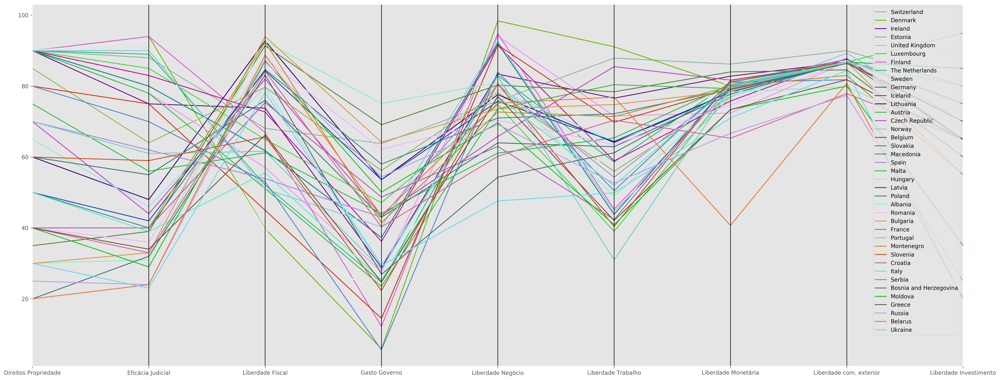

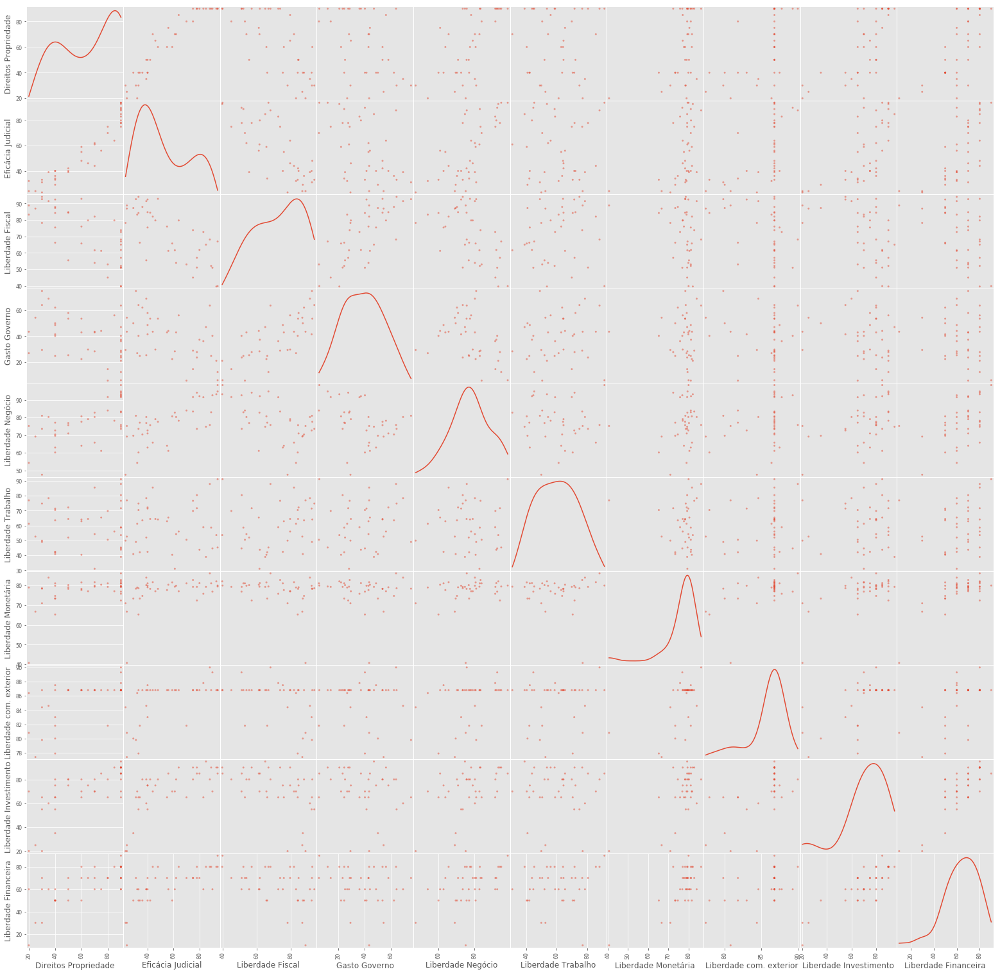

In [6]:
# média de cada continente em função das variáveis
for idx in df_europa.index:
    df_europa.loc[idx,'País'] = idx
plt.figure(figsize=(30, 12), dpi=300)
pd.plotting.parallel_coordinates(df_europa, 'País', cols=df_europa.columns[:9]);

# correlação entre as 10 variáveis da base
pd.plotting.scatter_matrix(df_europa, figsize=(27,27), diagonal='kde', grid=False);

### Principal Component Analisys (PCA)

/usr/lib/python3/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by the scale function.
  


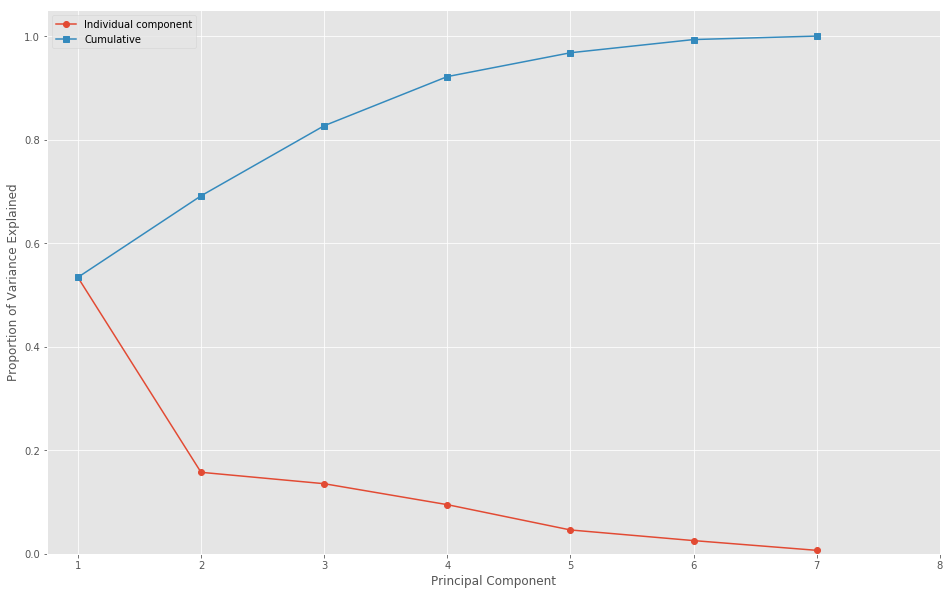

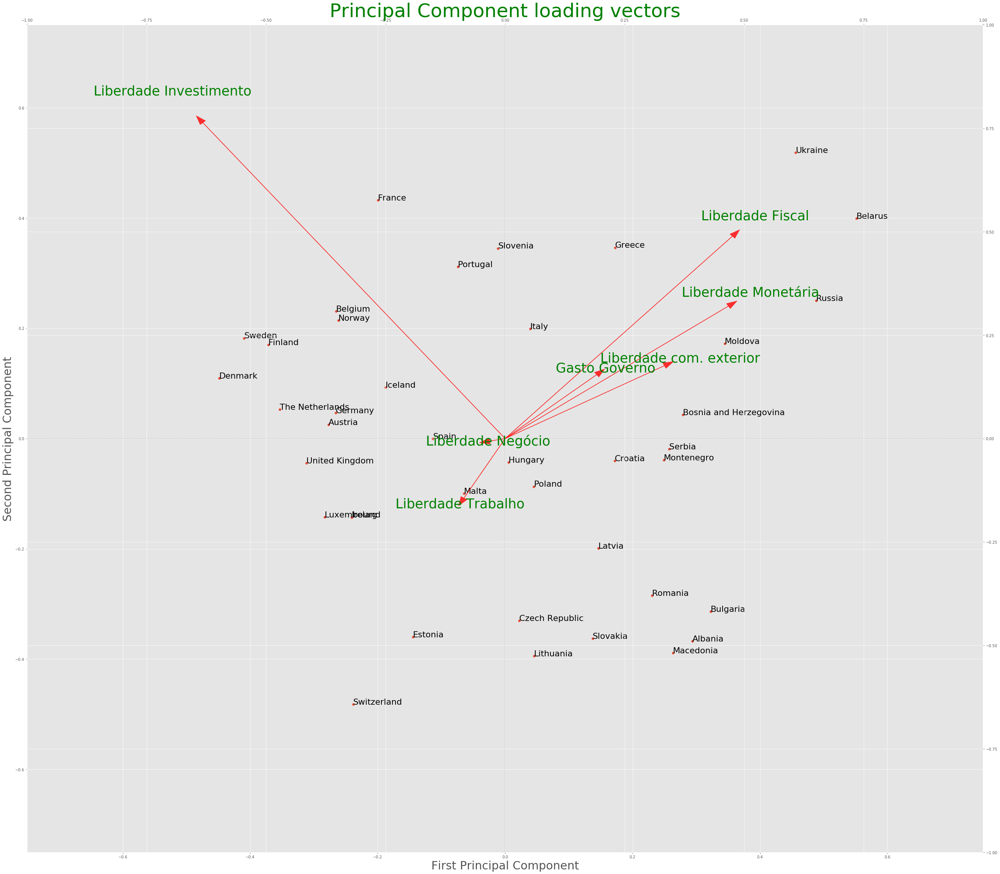

In [7]:
# Normalizando o dataset para a aplicação do PCA.
df_scaled = pd.DataFrame(scale(df_europa.iloc[:,:9]), index=df_europa.index, columns=df_europa.columns[:9])

# Efetuando o PCA
pca = PCA()
pca.fit_transform(df_scaled.iloc[:, :-2])
plt.figure(figsize=(16, 10))

plt.plot(np.arange(1,pca.n_components_+1), pca.explained_variance_ratio_, '-o', label='Individual component')
plt.plot(np.arange(1,pca.n_components_+1), np.cumsum(pca.explained_variance_ratio_), '-s', label='Cumulative')

plt.ylabel('Proportion of Variance Explained')
plt.xlabel('Principal Component')
plt.xlim(0.75,4.25)
plt.ylim(0,1.05)
plt.xticks(np.arange(1,pca.n_components_+2))
plt.legend(loc=2);

# Aplicando o PCA para a geração do gráfico dos dois primeiros componentes.
pca = PCA()
df_plot = pd.DataFrame(pca.fit_transform(df_europa.iloc[:,:10]),
                       columns=['PC'+str(i+1) for i in range(10)],
                       index=df_europa.index)

# The loading vectors
pca_loadings = pd.DataFrame(pca.fit(df_scaled.iloc[:, :-2]).components_.T,
                            index=df_scaled.columns[:-2],
                            columns=['PC'+str(i+1) for i in range(pca.n_components_)])

# Plotando em imagem
fig , ax1 = plt.subplots(figsize=(45, 40))

lim=0.75
ax1.set_xlim(-lim,lim)
ax1.set_ylim(-lim,lim)

# Plot reference lines
ax1.hlines(0,-lim,lim, linestyles='dotted', colors='grey')
ax1.vlines(0,-lim,lim, linestyles='dotted', colors='grey')

ax1.set_xlabel('First Principal Component', fontsize=30)
ax1.set_ylabel('Second Principal Component', fontsize=30)
    
# Plot Principal Component loading vectors, using a second y-axis.
ax2 = ax1.twinx().twiny() 

ax2.set_ylim(-1,1)
ax2.set_xlim(-1,1)
ax2.tick_params(axis='y', colors='g')
ax2.set_xlabel('Principal Component loading vectors', color='g', fontsize=50)

xs = df_plot.iloc[:, 0]
ys = df_plot.iloc[:, 1]

coeff = pca.components_
labels = df_europa.columns[2:]

scalex = 1.0/(xs.max()- xs.min())
scaley = 1.0/(ys.max()- ys.min())

ax1.scatter(xs*scalex, ys*scaley)
for i, country in enumerate(df_europa['País']):
    ax1.annotate(country, (xs[i]*scalex, ys[i]*scaley), fontsize=22)

for i in range(pca.n_components_):
        plt.arrow(0, 0, coeff[i, 0], coeff[i, 1],color='r',alpha=0.8, head_width=0.015) 
        if labels is None:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, "Var"+str(i+1), color='g', ha='center', va='center', fontsize=35)
        else:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, labels[i], color='g', ha='center', va='center', fontsize=35)

## Oceania

In [8]:
# leitura do dataset e tratamento dos anos de algumas colunas para evitar problemas na manipulação
df_oceania = pd.read_csv('oceania.csv', index_col='País')
df_oceania.rename(index=str, columns={"continente":"Continente",
                              "direitos de propriedade":"Direitos Propriedade",
                              "Gasto do Governo":"Gasto Governo",
                              "Liberdade de negócio":"Liberdade Negócio",
                              "Liberdade de trabalho":"Liberdade Trabalho",
                              "Liberdade de Investimento":"Liberdade Investimento",
                              "Liberdade de comércio exterior":"Liberdade com. exterior"},
                              inplace=True)

### Visualizações Gerais

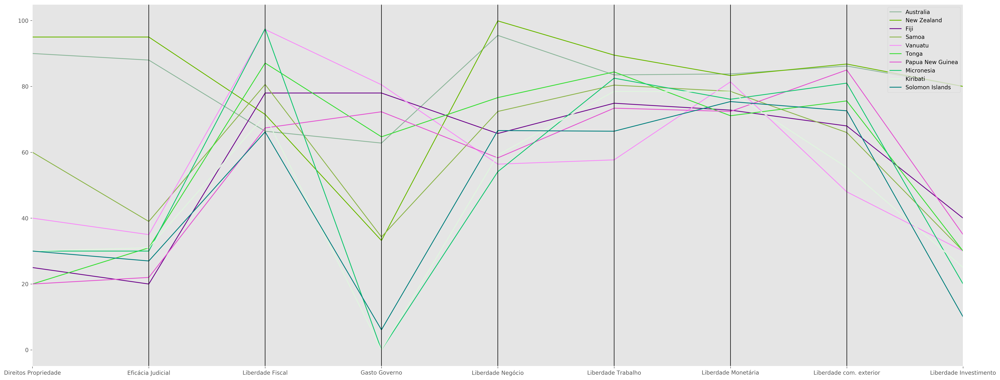

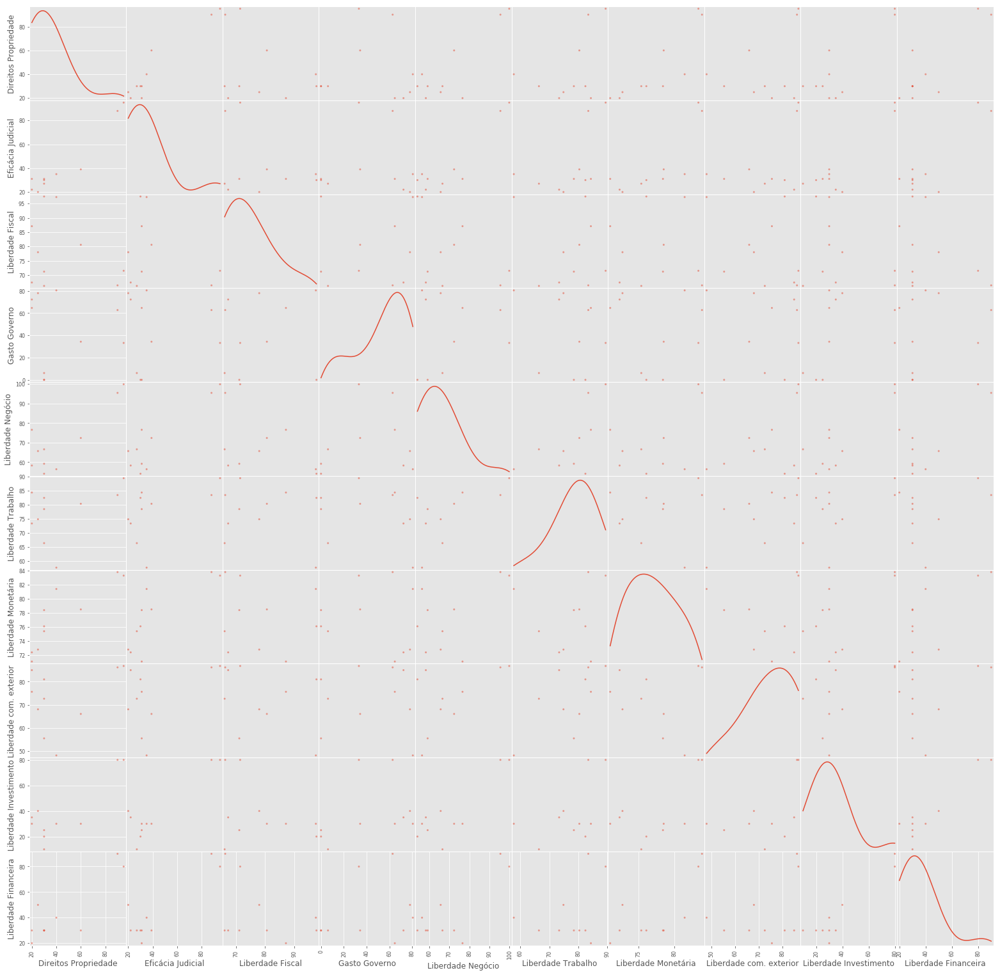

In [9]:
# média de cada continente em função das variáveis
for idx in df_oceania.index:
    df_oceania.loc[idx,'País'] = idx
plt.figure(figsize=(30, 12), dpi=300)
pd.plotting.parallel_coordinates(df_oceania, 'País', cols=df_oceania.columns[:9]);

# correlação entre as 10 variáveis da base
pd.plotting.scatter_matrix(df_oceania, figsize=(27,27), diagonal='kde', grid=False);

### Principal Component Analisys (PCA)

/usr/lib/python3/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by the scale function.
  


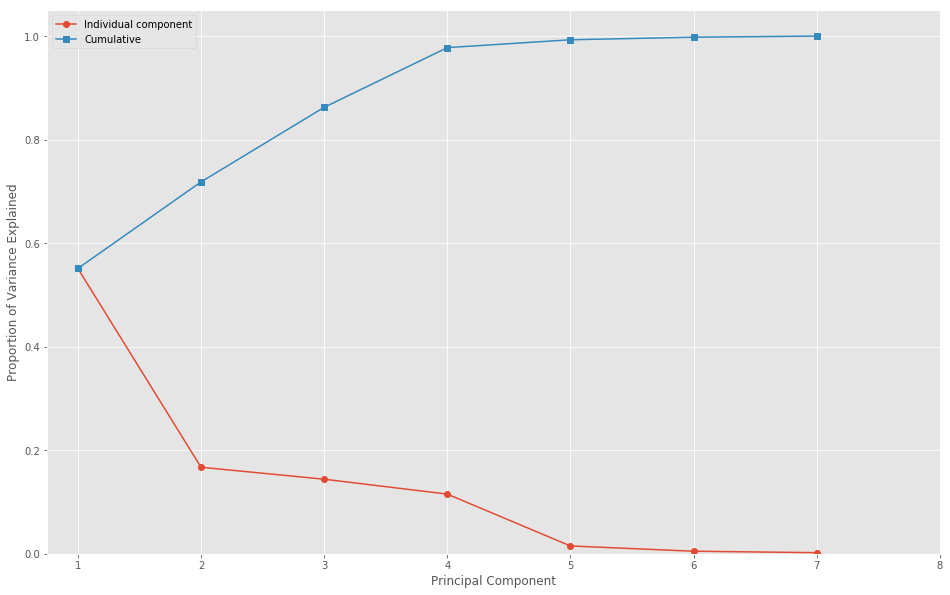

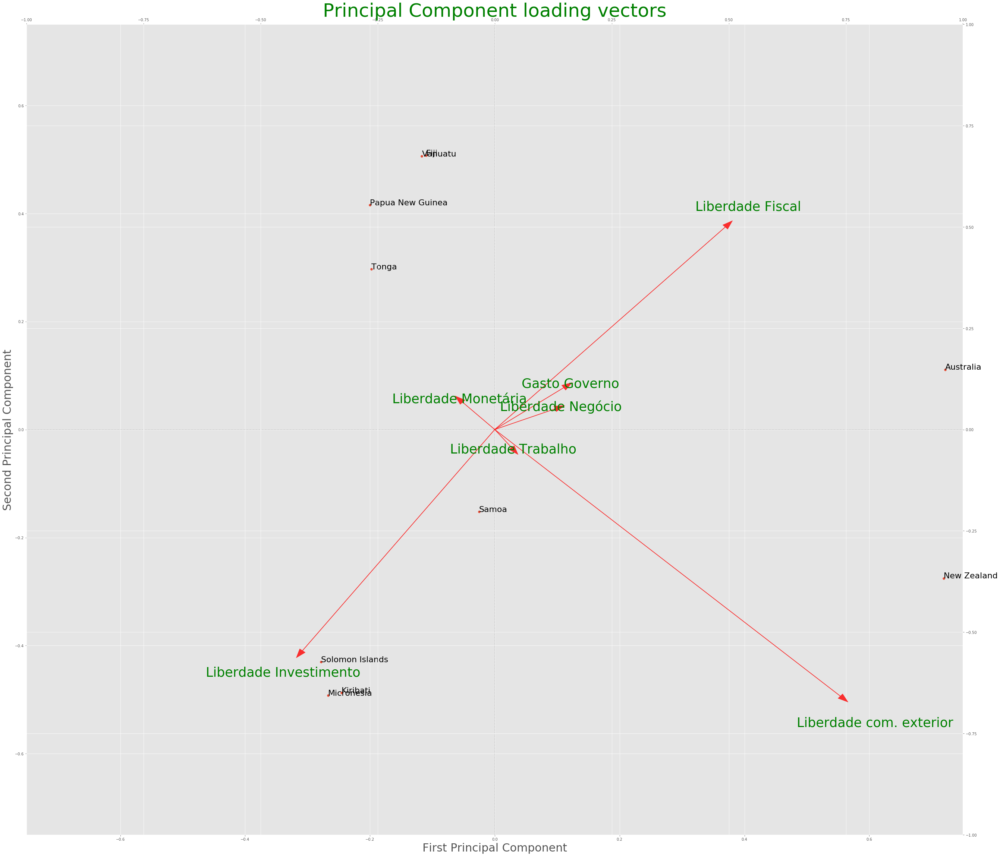

In [10]:
# Normalizando o dataset para a aplicação do PCA.
df_scaled = pd.DataFrame(scale(df_oceania.iloc[:,:9]), index=df_oceania.index, columns=df_oceania.columns[:9])

# Efetuando o PCA
pca = PCA()
pca.fit_transform(df_scaled.iloc[:, :-2])
plt.figure(figsize=(16, 10))

plt.plot(np.arange(1,pca.n_components_+1), pca.explained_variance_ratio_, '-o', label='Individual component')
plt.plot(np.arange(1,pca.n_components_+1), np.cumsum(pca.explained_variance_ratio_), '-s', label='Cumulative')

plt.ylabel('Proportion of Variance Explained')
plt.xlabel('Principal Component')
plt.xlim(0.75,4.25)
plt.ylim(0,1.05)
plt.xticks(np.arange(1,pca.n_components_+2))
plt.legend(loc=2);

# Aplicando o PCA para a geração do gráfico dos dois primeiros componentes.
pca = PCA()
df_plot = pd.DataFrame(pca.fit_transform(df_oceania.iloc[:,:10]),
                       columns=['PC'+str(i+1) for i in range(10)],
                       index=df_oceania.index)

# The loading vectors
pca_loadings = pd.DataFrame(pca.fit(df_scaled.iloc[:, :-2]).components_.T,
                            index=df_scaled.columns[:-2],
                            columns=['PC'+str(i+1) for i in range(pca.n_components_)])

# Plotando em imagem
fig , ax1 = plt.subplots(figsize=(45, 40))

lim=0.75
ax1.set_xlim(-lim,lim)
ax1.set_ylim(-lim,lim)

# Plot reference lines
ax1.hlines(0,-lim,lim, linestyles='dotted', colors='grey')
ax1.vlines(0,-lim,lim, linestyles='dotted', colors='grey')

ax1.set_xlabel('First Principal Component', fontsize=30)
ax1.set_ylabel('Second Principal Component', fontsize=30)
    
# Plot Principal Component loading vectors, using a second y-axis.
ax2 = ax1.twinx().twiny() 

ax2.set_ylim(-1,1)
ax2.set_xlim(-1,1)
ax2.tick_params(axis='y', colors='g')
ax2.set_xlabel('Principal Component loading vectors', color='g', fontsize=50)

xs = df_plot.iloc[:, 0]
ys = df_plot.iloc[:, 1]

coeff = pca.components_
labels = df_oceania.columns[2:]

scalex = 1.0/(xs.max()- xs.min())
scaley = 1.0/(ys.max()- ys.min())

ax1.scatter(xs*scalex, ys*scaley)
for i, country in enumerate(df_oceania['País']):
    ax1.annotate(country, (xs[i]*scalex, ys[i]*scaley), fontsize=22)

for i in range(pca.n_components_):
        plt.arrow(0, 0, coeff[i, 0], coeff[i, 1],color='r',alpha=0.8, head_width=0.015) 
        if labels is None:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, "Var"+str(i+1), color='g', ha='center', va='center', fontsize=35)
        else:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, labels[i], color='g', ha='center', va='center', fontsize=35)

## África

In [11]:
# leitura do dataset e tratamento dos anos de algumas colunas para evitar problemas na manipulação
df_africa = pd.read_csv('africa.csv', index_col='País')
df_africa.rename(index=str, columns={"continente":"Continente",
                              "direitos de propriedade":"Direitos Propriedade",
                              "Gasto do Governo":"Gasto Governo",
                              "Liberdade de negócio":"Liberdade Negócio",
                              "Liberdade de trabalho":"Liberdade Trabalho",
                              "Liberdade de Investimento":"Liberdade Investimento",
                              "Liberdade de comércio exterior":"Liberdade com. exterior"},
                              inplace=True)

### Visualizações Gerais

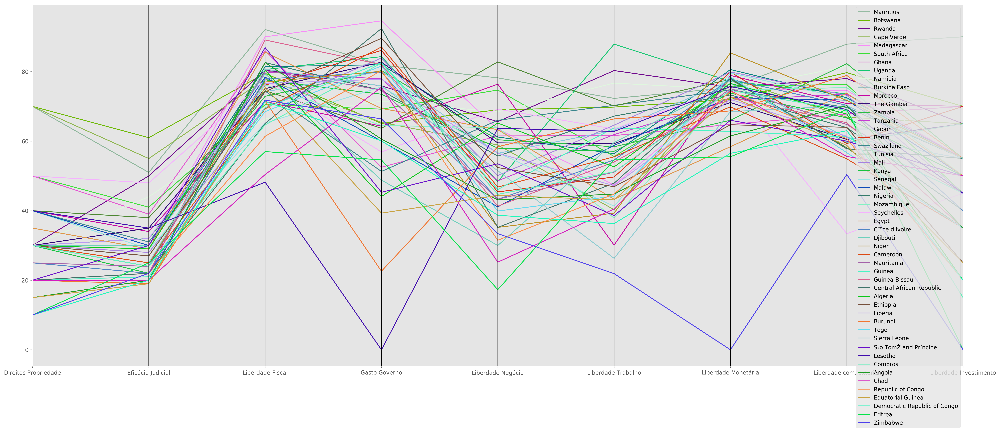

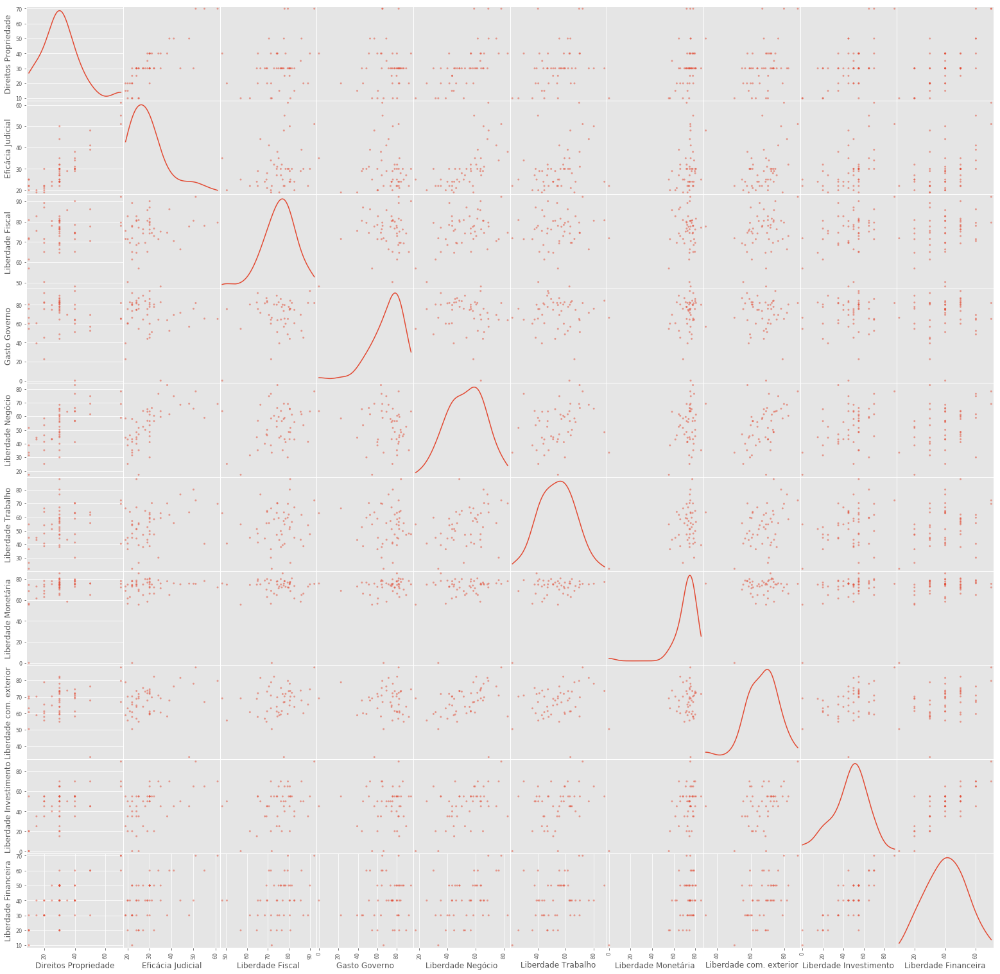

In [12]:
# média de cada continente em função das variáveis
for idx in df_africa.index:
    df_africa.loc[idx,'País'] = idx
plt.figure(figsize=(30, 12), dpi=300)
pd.plotting.parallel_coordinates(df_africa, 'País', cols=df_africa.columns[:9]);

# correlação entre as 10 variáveis da base
pd.plotting.scatter_matrix(df_africa, figsize=(27,27), diagonal='kde', grid=False);

### Principal Component Analisys (PCA)

/usr/lib/python3/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by the scale function.
  


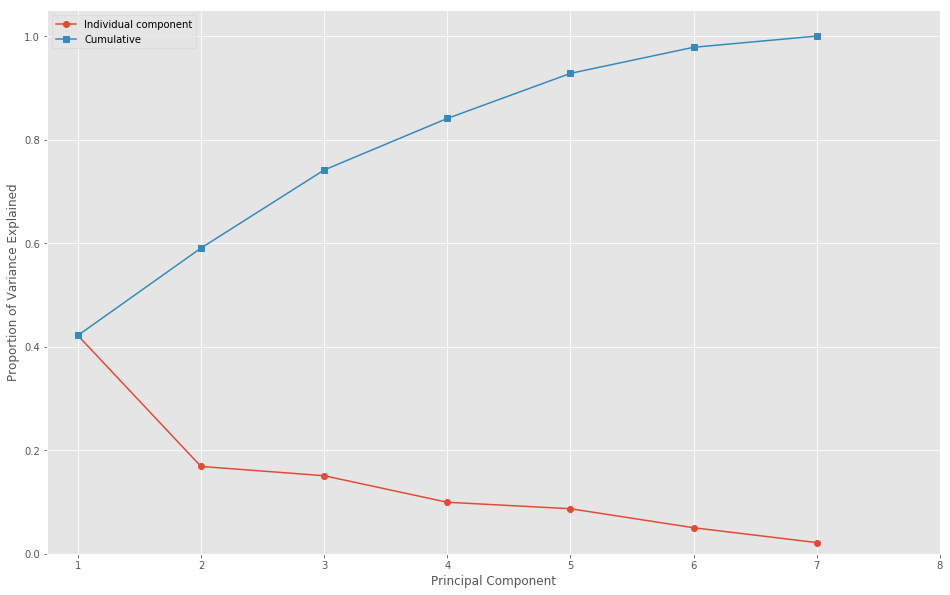

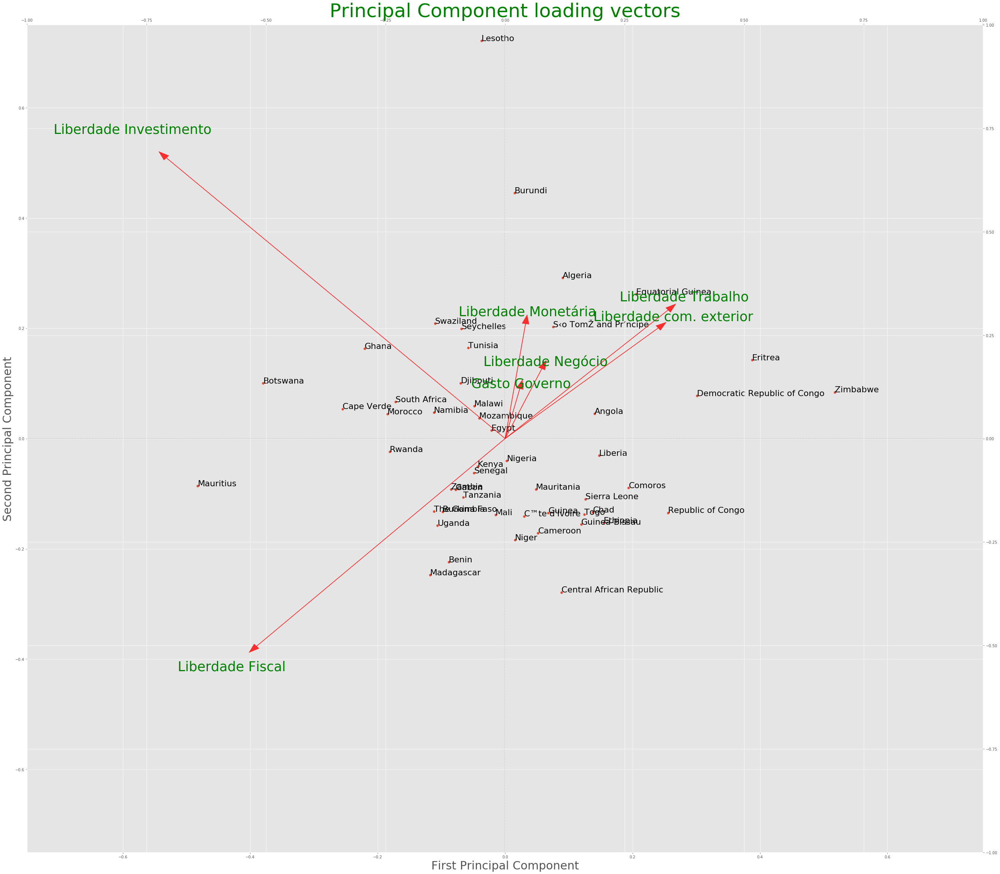

In [13]:
# Normalizando o dataset para a aplicação do PCA.
df_scaled = pd.DataFrame(scale(df_africa.iloc[:,:9]), index=df_africa.index, columns=df_africa.columns[:9])

# Efetuando o PCA
pca = PCA()
pca.fit_transform(df_scaled.iloc[:, :-2])
plt.figure(figsize=(16, 10))

plt.plot(np.arange(1,pca.n_components_+1), pca.explained_variance_ratio_, '-o', label='Individual component')
plt.plot(np.arange(1,pca.n_components_+1), np.cumsum(pca.explained_variance_ratio_), '-s', label='Cumulative')

plt.ylabel('Proportion of Variance Explained')
plt.xlabel('Principal Component')
plt.xlim(0.75,4.25)
plt.ylim(0,1.05)
plt.xticks(np.arange(1,pca.n_components_+2))
plt.legend(loc=2);

# Aplicando o PCA para a geração do gráfico dos dois primeiros componentes.
pca = PCA()
df_plot = pd.DataFrame(pca.fit_transform(df_africa.iloc[:,:10]),
                       columns=['PC'+str(i+1) for i in range(10)],
                       index=df_africa.index)

# The loading vectors
pca_loadings = pd.DataFrame(pca.fit(df_scaled.iloc[:, :-2]).components_.T,
                            index=df_scaled.columns[:-2],
                            columns=['PC'+str(i+1) for i in range(pca.n_components_)])

# Plotando em imagem
fig , ax1 = plt.subplots(figsize=(45, 40))

lim=0.75
ax1.set_xlim(-lim,lim)
ax1.set_ylim(-lim,lim)

# Plot reference lines
ax1.hlines(0,-lim,lim, linestyles='dotted', colors='grey')
ax1.vlines(0,-lim,lim, linestyles='dotted', colors='grey')

ax1.set_xlabel('First Principal Component', fontsize=30)
ax1.set_ylabel('Second Principal Component', fontsize=30)
    
# Plot Principal Component loading vectors, using a second y-axis.
ax2 = ax1.twinx().twiny() 

ax2.set_ylim(-1,1)
ax2.set_xlim(-1,1)
ax2.tick_params(axis='y', colors='g')
ax2.set_xlabel('Principal Component loading vectors', color='g', fontsize=50)

xs = df_plot.iloc[:, 0]
ys = df_plot.iloc[:, 1]

coeff = pca.components_
labels = df_africa.columns[2:]

scalex = 1.0/(xs.max()- xs.min())
scaley = 1.0/(ys.max()- ys.min())

ax1.scatter(xs*scalex, ys*scaley)
for i, country in enumerate(df_africa['País']):
    ax1.annotate(country, (xs[i]*scalex, ys[i]*scaley), fontsize=22)

for i in range(pca.n_components_):
        plt.arrow(0, 0, coeff[i, 0], coeff[i, 1],color='r',alpha=0.8, head_width=0.015) 
        if labels is None:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, "Var"+str(i+1), color='g', ha='center', va='center', fontsize=35)
        else:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, labels[i], color='g', ha='center', va='center', fontsize=35)

## Ásia

In [22]:
# leitura do dataset e tratamento dos anos de algumas colunas para evitar problemas na manipulação
df_asia = pd.read_csv('asia.csv', index_col='País')
df_asia.rename(index=str, columns={"continente":"Continente",
                              "direitos de propriedade":"Direitos Propriedade",
                              "Gasto do Governo":"Gasto Governo",
                              "Liberdade de negócio":"Liberdade Negócio",
                              "Liberdade de trabalho":"Liberdade Trabalho",
                              "Liberdade de Investimento":"Liberdade Investimento",
                              "Liberdade de comércio exterior":"Liberdade com. exterior"},
                              inplace=True)

### Visualizações Gerais

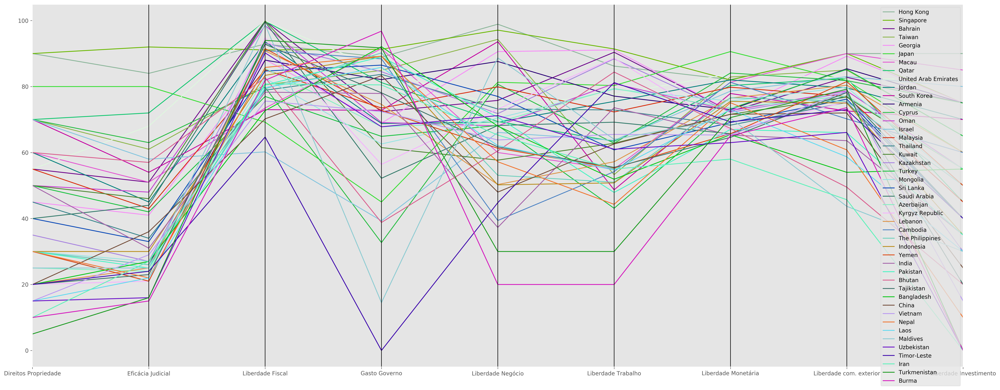

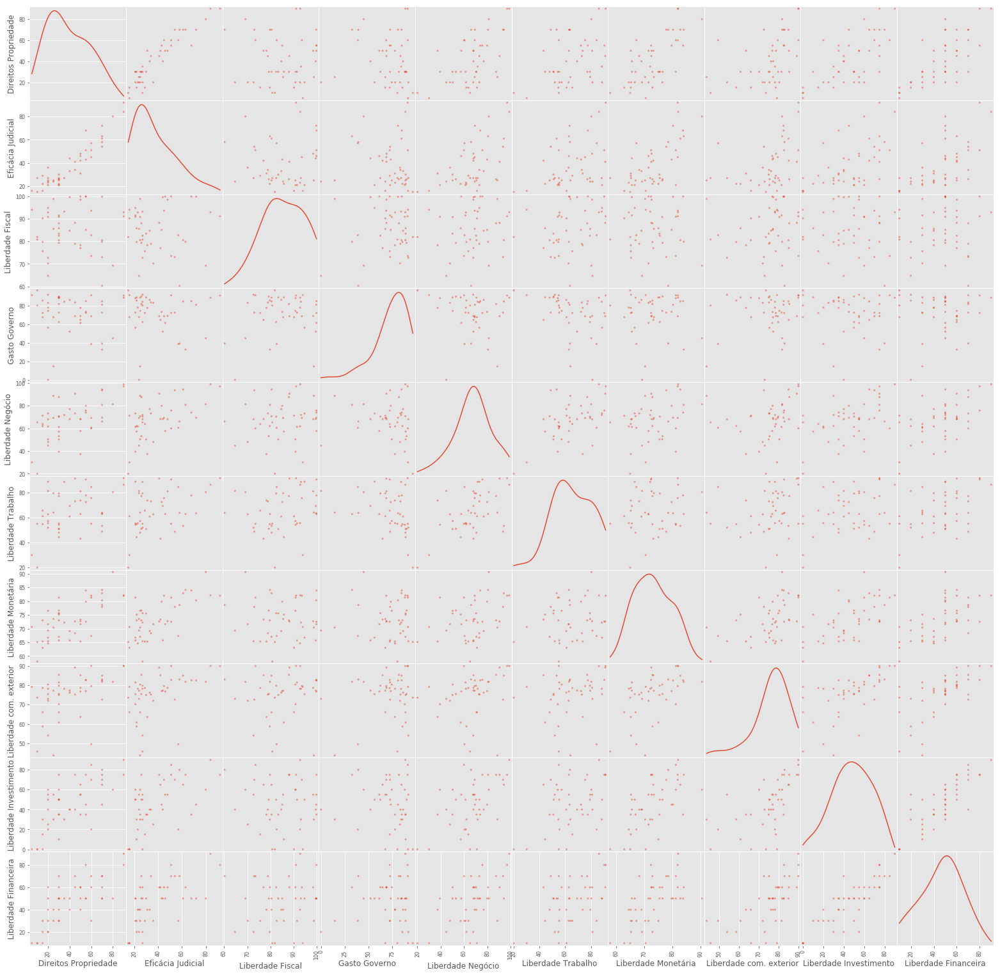

In [15]:
# média de cada continente em função das variáveis
for idx in df_asia.index:
    df_asia.loc[idx,'País'] = idx
plt.figure(figsize=(30, 12), dpi=300)
pd.plotting.parallel_coordinates(df_asia, 'País', cols=df_asia.columns[:9]);

# correlação entre as 10 variáveis da base
pd.plotting.scatter_matrix(df_asia, figsize=(27,27), diagonal='kde', grid=False);

### Principal Component Analisys (PCA)

/usr/lib/python3/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by the scale function.
  


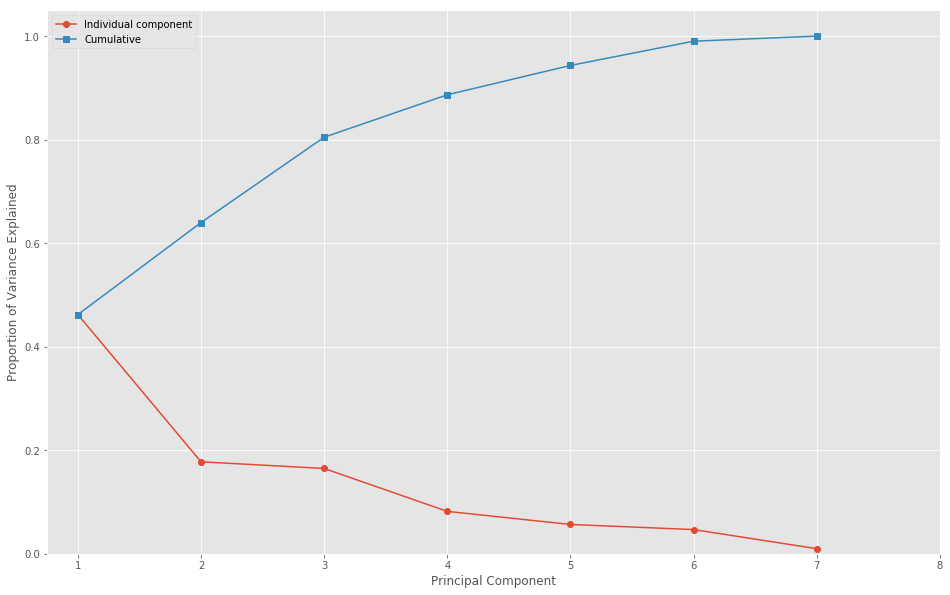

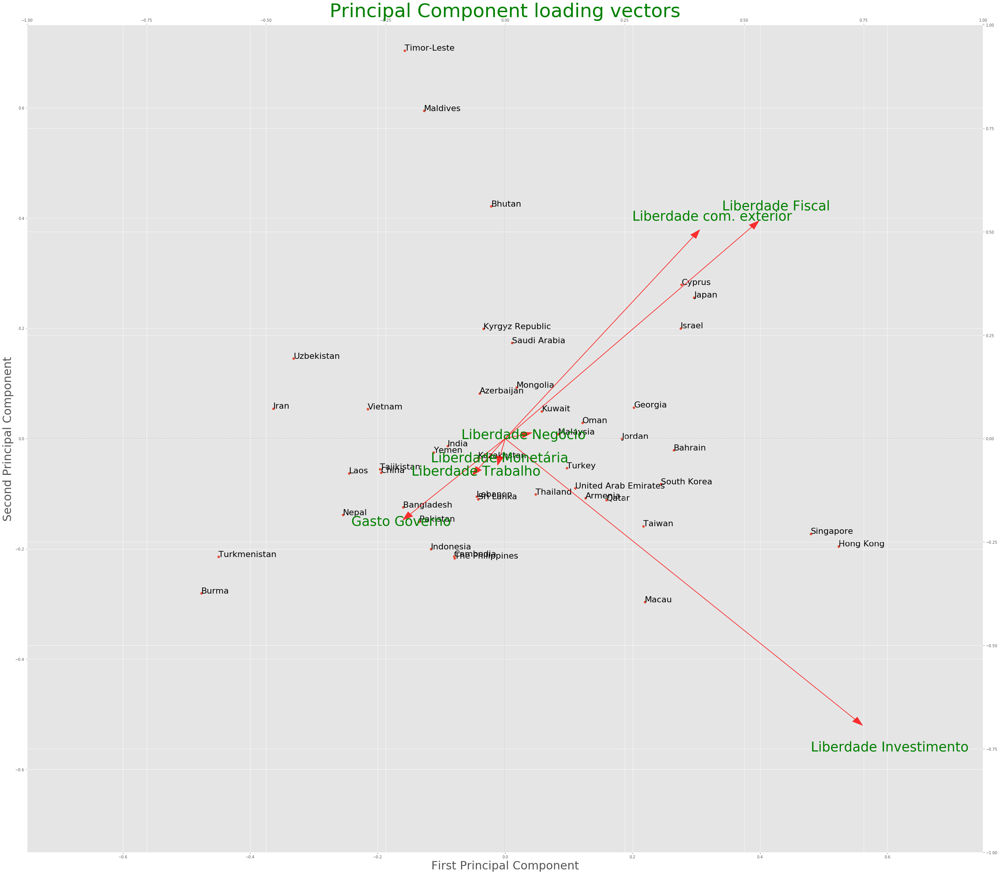

In [16]:
# Normalizando o dataset para a aplicação do PCA.
df_scaled = pd.DataFrame(scale(df_asia.iloc[:,:9]), index=df_asia.index, columns=df_asia.columns[:9])

# Efetuando o PCA
pca = PCA()
pca.fit_transform(df_scaled.iloc[:, :-2])
plt.figure(figsize=(16, 10))

plt.plot(np.arange(1,pca.n_components_+1), pca.explained_variance_ratio_, '-o', label='Individual component')
plt.plot(np.arange(1,pca.n_components_+1), np.cumsum(pca.explained_variance_ratio_), '-s', label='Cumulative')

plt.ylabel('Proportion of Variance Explained')
plt.xlabel('Principal Component')
plt.xlim(0.75,4.25)
plt.ylim(0,1.05)
plt.xticks(np.arange(1,pca.n_components_+2))
plt.legend(loc=2);

# Aplicando o PCA para a geração do gráfico dos dois primeiros componentes.
pca = PCA()
df_plot = pd.DataFrame(pca.fit_transform(df_asia.iloc[:,:10]),
                       columns=['PC'+str(i+1) for i in range(10)],
                       index=df_asia.index)

# The loading vectors
pca_loadings = pd.DataFrame(pca.fit(df_scaled.iloc[:, :-2]).components_.T,
                            index=df_scaled.columns[:-2],
                            columns=['PC'+str(i+1) for i in range(pca.n_components_)])

# Plotando em imagem
fig , ax1 = plt.subplots(figsize=(45, 40))

lim=0.75
ax1.set_xlim(-lim,lim)
ax1.set_ylim(-lim,lim)

# Plot reference lines
ax1.hlines(0,-lim,lim, linestyles='dotted', colors='grey')
ax1.vlines(0,-lim,lim, linestyles='dotted', colors='grey')

ax1.set_xlabel('First Principal Component', fontsize=30)
ax1.set_ylabel('Second Principal Component', fontsize=30)
    
# Plot Principal Component loading vectors, using a second y-axis.
ax2 = ax1.twinx().twiny() 

ax2.set_ylim(-1,1)
ax2.set_xlim(-1,1)
ax2.tick_params(axis='y', colors='g')
ax2.set_xlabel('Principal Component loading vectors', color='g', fontsize=50)

xs = df_plot.iloc[:, 0]
ys = df_plot.iloc[:, 1]

coeff = pca.components_
labels = df_asia.columns[2:]

scalex = 1.0/(xs.max()- xs.min())
scaley = 1.0/(ys.max()- ys.min())

ax1.scatter(xs*scalex, ys*scaley)
for i, country in enumerate(df_asia['País']):
    ax1.annotate(country, (xs[i]*scalex, ys[i]*scaley), fontsize=22)

for i in range(pca.n_components_):
        plt.arrow(0, 0, coeff[i, 0], coeff[i, 1],color='r',alpha=0.8, head_width=0.015) 
        if labels is None:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, "Var"+str(i+1), color='g', ha='center', va='center', fontsize=35)
        else:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, labels[i], color='g', ha='center', va='center', fontsize=35)

## Análise Mundial

In [17]:
df_america.insert(0, 'Continente', value='America')
df_asia.insert(0, 'Continente', value='Asia')
df_europa.insert(0, 'Continente', value='Europa')
df_africa.insert(0, 'Continente', value='Africa')
df_oceania.insert(0, 'Continente', value='Oceania')
df = pd.concat([df_america, df_europa, df_oceania, df_asia, df_africa], sort=True)

In [19]:
# exemplo de instâncias
df.head()

,Continente,Direitos Propriedade,Eficácia Judicial,Gasto Governo,Liberdade Financeira,Liberdade Fiscal,Liberdade Investimento,Liberdade Monetária,Liberdade Negócio,Liberdade Trabalho,Liberdade com. exterior,País
País,,,,,,,,,,,,
Canada,America,90,87,44.8,80,79.8,75,75.2,91.7,82.3,88.2,Canada
Chile,America,90,72,83.7,70,77.6,85,84.6,70.5,74.2,82.0,Chile
United States,America,85,71,47.8,70,69.3,70,75.0,90.5,95.5,86.4,United States
Saint Lucia,America,70,70,63.6,40,76.9,65,84.7,85.3,76.4,71.9,Saint Lucia
The Bahamas,America,70,73,84.9,70,97.0,30,75.8,71.3,81.6,47.0,The Bahamas


In [18]:
# descrição geral das colunas do conjunto de dados
df.describe()

,Direitos Propriedade,Eficácia Judicial,Gasto Governo,Liberdade Financeira,Liberdade Fiscal,Liberdade Investimento,Liberdade Monetária,Liberdade Negócio,Liberdade Trabalho,Liberdade com. exterior
count,176.000000,176.000000,176.000000,176.000000,176.000000,176.000000,176.000000,176.000000,176.000000,176.000000
mean,43.579545,40.767045,61.418182,49.034091,77.682955,52.500000,74.089205,64.943750,60.943182,74.890341
std,24.218633,21.059840,23.820193,19.054178,12.162647,23.476432,8.988548,17.548514,16.514328,11.153412
min,5.000000,0.000000,0.000000,10.000000,39.600000,0.000000,0.000000,10.000000,20.000000,33.400000
25%,30.000000,25.000000,46.650000,30.000000,71.350000,35.000000,71.750000,54.000000,49.525000,68.075000
50%,40.000000,32.500000,66.350000,50.000000,79.100000,55.000000,75.450000,65.900000,61.750000,76.900000
75%,60.000000,51.000000,80.350000,60.000000,85.525000,70.000000,79.300000,76.675000,73.750000,85.000000
max,95.000000,95.000000,96.800000,90.000000,99.900000,95.000000,90.600000,99.900000,95.500000,90.000000


### Visualizações Gerais

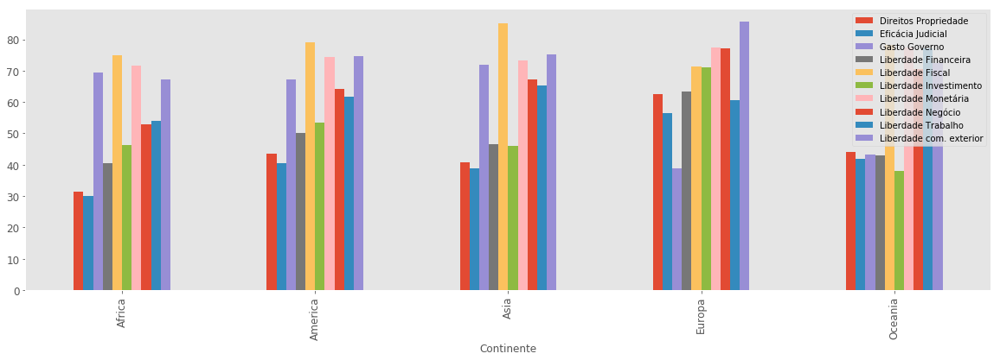

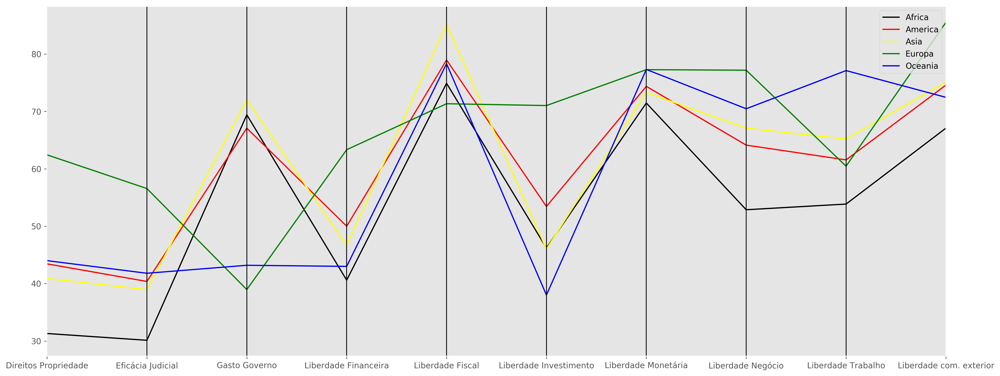

In [20]:
# média de cada varável por continente
data = df.groupby(by='Continente').mean()
data.plot(kind='bar', figsize=(20,6), grid=False, fontsize=12, sort_columns=True);

# média de cada continente em função das variáveis
data = df.groupby('Continente').mean()
data['Continente'] = df.Continente.copy()
for idx in data.index:
    data.loc[idx,'Continente'] = idx

plt.figure(figsize=(20, 8), dpi=300)
pd.plotting.parallel_coordinates(data, 'Continente', cols=data.columns[:10],
                                 color=['black', 'red', 'yellow', 'green', 'blue']);

### Principal Component Analisys

/usr/lib/python3/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by the scale function.
  


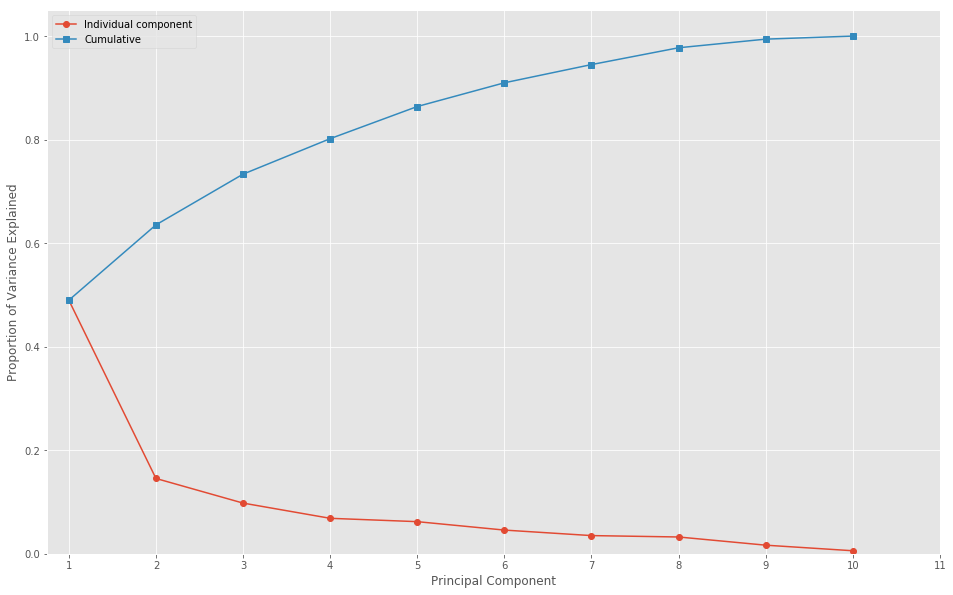

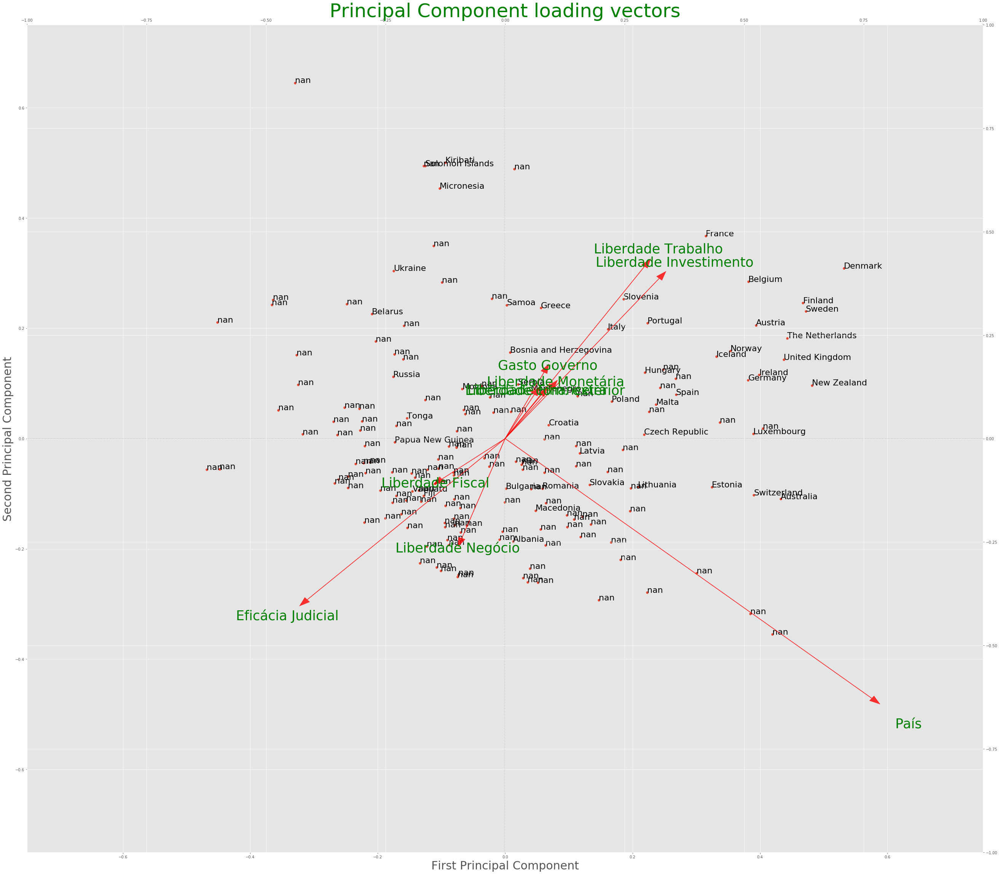

In [304]:
# Normalizando o dataset para a aplicação do PCA.
df_scaled = pd.DataFrame(scale(df.iloc[:, 1:11]), index=df.index, columns=df.columns[1:11])
df_scaled['Continente'] = df.Continente.copy()
df_scaled['País'] = df['País'].copy()

# Aplicando o PCA
pca = PCA()
pca.fit_transform(df_scaled.iloc[:, :-2])
plt.figure(figsize=(16, 10))

plt.plot(np.arange(1,pca.n_components_+1), pca.explained_variance_ratio_, '-o', label='Individual component')
plt.plot(np.arange(1,pca.n_components_+1), np.cumsum(pca.explained_variance_ratio_), '-s', label='Cumulative')

plt.ylabel('Proportion of Variance Explained')
plt.xlabel('Principal Component')
plt.xlim(0.75,4.25)
plt.ylim(0,1.05)
plt.xticks(np.arange(1,pca.n_components_+2))
plt.legend(loc=2);

# Aplicando o PCA para a geração do gráfico dos dois primeiros componentes.
pca = PCA()
df_plot = pd.DataFrame(pca.fit_transform(df.iloc[:, 1:11]), columns=['PC'+str(i+1) for i in range(10)], index=df.index)

# The loading vectors
pca_loadings = pd.DataFrame(pca.fit(df_scaled.iloc[:, :-2]).components_.T, index=df_scaled.columns[:-2],
                            columns=['PC'+str(i+1) for i in range(pca.n_components_)])

fig , ax1 = plt.subplots(figsize=(45, 40))

lim=0.75
ax1.set_xlim(-lim,lim)
ax1.set_ylim(-lim,lim)

# Plot reference lines
ax1.hlines(0,-lim,lim, linestyles='dotted', colors='grey')
ax1.vlines(0,-lim,lim, linestyles='dotted', colors='grey')

ax1.set_xlabel('First Principal Component', fontsize=30)
ax1.set_ylabel('Second Principal Component', fontsize=30)
    
# Plot Principal Component loading vectors, using a second y-axis.
ax2 = ax1.twinx().twiny() 

ax2.set_ylim(-1,1)
ax2.set_xlim(-1,1)
ax2.tick_params(axis='y', colors='g')
ax2.set_xlabel('Principal Component loading vectors', color='g', fontsize=50)

xs = df_plot.iloc[:, 0]
ys = df_plot.iloc[:, 1]

coeff = pca.components_
labels = df.columns[2:]

scalex = 1.0/(xs.max()- xs.min())
scaley = 1.0/(ys.max()- ys.min())

ax1.scatter(xs*scalex, ys*scaley)
for i, country in enumerate(df['País']):
    ax1.annotate(country, (xs[i]*scalex, ys[i]*scaley), fontsize=22)

for i in range(pca.n_components_):
        plt.arrow(0, 0, coeff[i, 0], coeff[i, 1],color='r',alpha=0.8, head_width=0.015) 
        if labels is None:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, "Var"+str(i+1), color='g', ha='center', va='center', fontsize=35)
        else:
            plt.text(coeff[i, 0]* 1.1, coeff[i, 1] * 1.1, labels[i], color='g', ha='center', va='center', fontsize=35)